## Importação dos Dados

In [467]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [610]:
df_heart = pd.read_csv('cardio_train.csv', sep=';', index_col=0)
df_heart

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,17474,1,156,56.0,100,60,1,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
99993,19240,2,168,76.0,120,80,1,1,1,0,1,0
99995,22601,1,158,126.0,140,90,2,2,0,0,1,1
99996,19066,2,183,105.0,180,90,3,1,0,1,0,1


In [469]:
df_heart.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 70000 entries, 0 to 99999
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          70000 non-null  int64  
 1   gender       70000 non-null  int64  
 2   height       70000 non-null  int64  
 3   weight       70000 non-null  float64
 4   ap_hi        70000 non-null  int64  
 5   ap_lo        70000 non-null  int64  
 6   cholesterol  70000 non-null  int64  
 7   gluc         70000 non-null  int64  
 8   smoke        70000 non-null  int64  
 9   alco         70000 non-null  int64  
 10  active       70000 non-null  int64  
 11  cardio       70000 non-null  int64  
dtypes: float64(1), int64(11)
memory usage: 6.9 MB


In [470]:
df_heart.describe()

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
count,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000
mean,19468.865814,1.349571,164.359229,74.205690,128.817286,96.630414,1.366871,1.226457,0.088129,0.053771,0.803729,0.499700
std,2467.251667,0.476838,8.210126,14.395757,154.011419,188.472530,0.680250,0.572270,0.283484,0.225568,0.397179,0.500003
min,10798.000000,1.000000,55.000000,10.000000,-150.000000,-70.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,17664.000000,1.000000,159.000000,65.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
50%,19703.000000,1.000000,165.000000,72.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
75%,21327.000000,2.000000,170.000000,82.000000,140.000000,90.000000,2.000000,1.000000,0.000000,0.000000,1.000000,1.000000
max,23713.000000,2.000000,250.000000,200.000000,16020.000000,11000.000000,3.000000,3.000000,1.000000,1.000000,1.000000,1.000000


In [471]:
df_heart.mean()

age            19468.865814
gender             1.349571
height           164.359229
weight            74.205690
ap_hi            128.817286
ap_lo             96.630414
cholesterol        1.366871
gluc               1.226457
smoke              0.088129
alco               0.053771
active             0.803729
cardio             0.499700
dtype: float64

## Análise Exploratória dos Dados

In [472]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [473]:
fig = make_subplots(rows=5, cols=1)
fig.add_trace(go.Box(x=df_heart['age'] / 365, name='Idade'), row=1, col=1)
fig.add_trace(go.Box(x=df_heart['weight'], name='Peso'), row=2, col=1)
fig.add_trace(go.Box(x=df_heart['height'], name='Altura'), row=3, col=1)
fig.add_trace(go.Box(x=df_heart['ap_hi'], name='Pressão arterial sistólica'), row=4, col=1)
fig.add_trace(go.Box(x=df_heart['ap_lo'], name='Pressão arterial diastólica'), row=5, col=1)

fig.update_layout(height=700)
fig.show()

In [474]:
fig2 = make_subplots(rows=2, cols=3)
fig2.add_trace(go.Bar(y=df_heart['gender'].value_counts(), x=['Feminino','Masculino'], name='Gênero'), row=1, col=1)
fig2.add_trace(go.Bar(y=df_heart['cholesterol'].value_counts(), x=['Normal','Acima do Normal','Muito Acima do Normal'], name='Colesterol'), row=1, col=2)
fig2.add_trace(go.Bar(y=df_heart['gluc'].value_counts(), x=['Normal','Acima do Normal','Muito Acima do Normal'], name='Glicose'), row=1, col=3)
fig2.add_trace(go.Bar(y=df_heart['smoke'].value_counts(), x=['Não Fumante', 'Fumante'], name='Fumante'), row=2, col=1)
fig2.add_trace(go.Bar(y=df_heart['alco'].value_counts(), x=['Não Alcoólatra', 'Alcoólatra'], name='Alcoólatra'), row=2, col=2)
fig2.add_trace(go.Bar(y=df_heart['active'].value_counts(), x=['Ativo Fisicamente', 'Não Ativo Fisicamente'], name='Atividade Física'), row=2, col=3)
fig2.update_layout(height=700)
fig2.show()

In [475]:
df_heart['cardio'].value_counts() / df_heart['cardio'].value_counts().sum()

0    0.5003
1    0.4997
Name: cardio, dtype: float64

In [476]:
cardio_fig = make_subplots(rows=1,cols=1)
cardio_fig.add_trace(go.Bar(y=df_heart['cardio'].value_counts(), x=['Não Possui Doença Cardíaca','Possui Doença Cardíaca'], name='Doença'), row=1, col=1)

<Axes: >

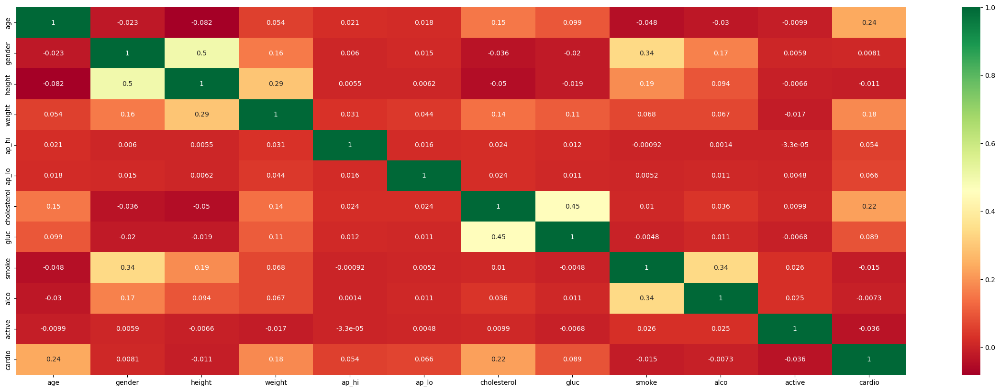

In [477]:
import seaborn as sns
fig3, ax = plt.subplots(figsize=(30,10))
sns.heatmap(df_heart.corr(), annot=True, cmap='RdYlGn')

## Removendo Outliers

<Axes: >

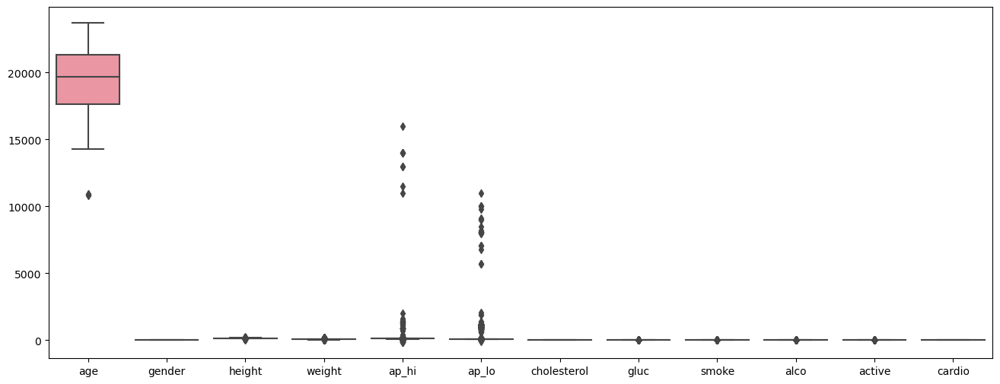

In [478]:
plt.figure(figsize=(16,6))
sns.boxplot(data = df_heart)

In [479]:
df_heart.describe()

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
count,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000
mean,19468.865814,1.349571,164.359229,74.205690,128.817286,96.630414,1.366871,1.226457,0.088129,0.053771,0.803729,0.499700
std,2467.251667,0.476838,8.210126,14.395757,154.011419,188.472530,0.680250,0.572270,0.283484,0.225568,0.397179,0.500003
min,10798.000000,1.000000,55.000000,10.000000,-150.000000,-70.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,17664.000000,1.000000,159.000000,65.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
50%,19703.000000,1.000000,165.000000,72.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
75%,21327.000000,2.000000,170.000000,82.000000,140.000000,90.000000,2.000000,1.000000,0.000000,0.000000,1.000000,1.000000
max,23713.000000,2.000000,250.000000,200.000000,16020.000000,11000.000000,3.000000,3.000000,1.000000,1.000000,1.000000,1.000000


In [480]:
fig4 = make_subplots(rows=5, cols=1)
fig4.add_trace(go.Box(x=df_heart['age'], name='Idade'), row=1, col=1)
fig4.add_trace(go.Box(x=df_heart['height'], name='Altura'), row=2, col=1)
fig4.add_trace(go.Box(x=df_heart['weight'], name='Peso'), row=3, col=1)
fig4.add_trace(go.Box(x=df_heart['ap_hi'], name='Pressão arterial sistólica'), row=4, col=1)
fig4.add_trace(go.Box(x=df_heart['ap_lo'], name='Pressão arterial diastólica'), row=5, col=1)

### Método Z-Score

In [611]:
lower_limit = df_heart['age'].mean() - (3 * df_heart['age'].std())

In [612]:
lower_limit

12067.11081256154

In [613]:
df_heart.loc[df_heart['age'] < lower_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
8850,10878,1,175,59.0,120,80,1,1,0,0,1,0
31922,10798,2,175,92.0,100,60,1,1,0,0,1,0
43842,10859,1,159,59.0,120,80,1,1,0,0,1,0
79749,10964,1,160,59.0,110,70,1,1,0,0,1,0


In [614]:
df_heart = df_heart[df_heart['age'] > lower_limit]

In [615]:
len(df_heart)

69996

In [616]:
upper_limit = df_heart['height'].mean() + (5 * df_heart['height'].std())

In [617]:
lower_limit = df_heart['height'].mean() - (3 * df_heart['height'].std())

In [618]:
upper_limit

205.40967538868495

In [619]:
lower_limit

139.72869616686904

In [620]:
df_heart.loc[df_heart['height'] > upper_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
9223,21220,1,250,86.0,140,100,3,1,0,0,1,1
30894,19054,2,207,78.0,100,70,1,1,0,1,1,0


In [621]:
df_heart.loc[df_heart['height'] < lower_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
309,21800,2,76,55.0,120,80,1,1,0,0,1,0
3399,22629,2,138,52.0,140,100,1,1,0,0,1,1
4150,19591,1,134,52.0,120,70,1,1,0,0,0,0
4523,18285,1,136,57.0,120,80,1,1,0,0,1,0
4838,14516,1,100,70.0,100,70,1,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...
94906,16928,2,110,90.0,110,90,1,1,0,0,1,0
95141,18830,1,57,61.0,130,90,1,1,0,0,1,1
96921,21763,1,133,123.0,180,100,2,1,0,0,1,1


In [622]:
df_heart = df_heart[df_heart['height'] < upper_limit]

In [623]:
df_heart = df_heart[df_heart['height'] > lower_limit]

In [624]:
len(df_heart)

69842

In [625]:
upper_limit = df_heart['weight'].mean() + (3 * df_heart['weight'].std())

In [626]:
lower_limit = df_heart['weight'].mean() - (3 * df_heart['weight'].std())

In [627]:
upper_limit

117.25774187936283

In [628]:
lower_limit

31.149826632420925

In [629]:
df_heart.loc[df_heart['weight'] > upper_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
474,21078,1,157,142.0,120,80,1,1,0,0,1,1
552,16718,2,165,169.0,120,80,1,1,0,0,1,0
618,16765,1,186,200.0,130,70,1,1,0,0,0,0
634,21237,2,178,120.0,160,90,1,3,0,0,1,1
846,14705,1,164,125.0,130,90,1,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
98584,18317,1,170,123.0,130,90,1,1,0,0,1,0
98640,18924,1,163,119.0,160,90,1,1,0,0,1,1
98709,19077,2,175,155.0,110,100,1,1,0,0,1,1


In [630]:
df_heart.loc[df_heart['weight'] < lower_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
24167,17272,2,170,31.0,150,90,2,2,0,0,1,1
26503,18140,1,160,30.0,120,80,1,1,0,0,1,1
38312,23284,1,157,23.0,110,80,1,1,0,0,1,0
42156,20408,2,177,22.0,120,80,1,1,1,1,1,0
48318,21582,2,178,11.0,130,90,1,1,0,0,1,1
59853,21334,1,143,30.0,103,61,2,1,0,0,1,0
82567,18804,2,165,10.0,180,1100,2,2,0,0,1,1
85931,21855,1,162,21.0,120,80,2,1,0,0,1,1
86650,18875,1,171,29.0,110,70,2,1,0,0,1,1


In [631]:
df_heart = df_heart[df_heart['weight'] < upper_limit]

In [632]:
df_heart = df_heart[df_heart['weight'] > lower_limit]

In [633]:
len(df_heart)

69153

In [634]:
upper_limit = df_heart['ap_hi'].mean() + (1 * df_heart['ap_hi'].std())

In [635]:
lower_limit = df_heart['ap_hi'].mean() - (0.7 * df_heart['ap_hi'].std())

In [636]:
upper_limit

283.63764751142

In [637]:
lower_limit

20.256476698768566

In [638]:
df_heart.loc[df_heart['ap_hi'] > upper_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
2654,15116,1,160,60.0,902,60,1,1,0,0,1,0
2845,22712,2,167,59.0,906,0,1,1,0,0,1,0
6822,14425,1,168,63.0,909,60,2,1,0,0,1,0
11089,21032,1,175,80.0,11500,90,1,1,0,0,1,1
12710,18870,1,164,75.0,1420,80,2,1,0,0,1,1
13616,22659,1,155,87.0,701,110,1,1,0,0,1,1
19827,15996,1,168,72.0,1500,80,1,1,0,0,1,1
25314,22398,2,163,50.0,907,70,3,3,0,0,1,1
34120,16131,1,161,92.0,906,0,2,1,0,0,1,1


In [639]:
df_heart.loc[df_heart['ap_hi'] < lower_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
815,21281,1,168,78.0,14,90,2,1,0,0,1,1
1294,21867,2,175,70.0,14,90,3,1,0,0,1,1
1360,18225,1,172,65.0,11,80,1,3,0,0,1,0
2260,19201,1,165,66.0,12,80,1,1,0,0,1,0
2301,22591,1,165,71.0,14,80,1,1,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
98039,21217,1,160,59.0,12,80,1,1,0,0,1,0
98213,18755,1,158,74.0,14,90,1,1,0,0,1,1
98568,19107,1,154,77.0,14,90,1,1,0,0,1,0


In [640]:
df_heart.loc[df_heart['ap_hi'] > upper_limit, 'ap_hi'] = upper_limit

In [641]:
df_heart.loc[df_heart['ap_hi'] < lower_limit, 'ap_hi'] = lower_limit

In [642]:
len(df_heart)

69153

In [643]:
upper_limit = df_heart['ap_lo'].mean() + (1 * df_heart['ap_lo'].std())

In [644]:
lower_limit = df_heart['ap_lo'].mean() - (0.4 * df_heart['ap_lo'].std())

In [645]:
upper_limit

284.88167766439943

In [646]:
lower_limit

20.911100571045566

In [647]:
df_heart.loc[df_heart['ap_lo'] > upper_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
314,17489,2,183,98.0,160.0,1100,1,2,1,0,1,1
334,21932,2,157,60.0,160.0,1000,2,1,0,0,0,1
357,18217,1,150,83.0,140.0,800,1,1,0,0,1,1
458,23407,1,176,63.0,160.0,1000,2,2,0,0,0,1
482,18704,1,154,81.0,140.0,1000,2,1,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
99659,23330,1,167,81.0,160.0,1000,1,1,0,0,1,1
99798,21808,1,152,56.0,160.0,1000,1,1,0,0,1,1
99807,21239,2,168,95.0,160.0,1000,1,1,0,0,1,1


In [648]:
df_heart.loc[df_heart['ap_lo'] < lower_limit]

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
id,,,,,,,,,,,,
2845,22712,2,167,59.0,283.637648,0,1,1,0,0,1,0
9610,16705,1,156,61.0,150.000000,10,1,1,0,0,0,1
12550,21155,1,162,68.0,110.000000,20,1,1,0,0,1,0
14410,18334,1,152,50.0,150.000000,10,3,1,0,0,1,1
16884,18171,1,169,69.0,128.000000,20,1,1,0,0,1,1
19258,14965,2,150,60.0,130.000000,0,1,1,0,0,0,0
19885,18007,1,164,74.0,110.000000,20,1,1,0,0,1,0
23512,20457,1,156,50.0,138.000000,0,3,1,0,0,1,1
24837,18226,1,164,78.0,138.000000,0,1,1,0,0,1,0


In [649]:
df_heart.loc[df_heart['ap_lo'] > upper_limit, 'ap_lo'] = upper_limit

In [650]:
df_heart.loc[df_heart['ap_lo'] < lower_limit, 'ap_lo'] = lower_limit

In [651]:
len(df_heart)

69153

In [652]:
fig4 = make_subplots(rows=5, cols=1)
fig4.add_trace(go.Box(x=df_heart['age'], name='Idade'), row=1, col=1)
fig4.add_trace(go.Box(x=df_heart['height'], name='Altura'), row=2, col=1)
fig4.add_trace(go.Box(x=df_heart['weight'], name='Peso'), row=3, col=1)
fig4.add_trace(go.Box(x=df_heart['ap_hi'], name='Pressão arterial sistólica'), row=4, col=1)
fig4.add_trace(go.Box(x=df_heart['ap_lo'], name='Pressão arterial diastólica'), row=5, col=1)

## Treinando Modelo de Machine Learning

In [653]:
Y = df_heart['cardio']
X = df_heart.loc[:, df_heart.columns != 'cardio']

In [654]:
from sklearn.model_selection import train_test_split

In [655]:
x_train, x_test, y_train, y_test = train_test_split(X,Y, test_size=0.33, random_state=42)

In [656]:
from sklearn.ensemble import RandomForestClassifier

In [657]:
ml_model = RandomForestClassifier(n_estimators=30, n_jobs=4, max_depth=8)
ml_model.fit(x_train, y_train)

RandomForestClassifier(max_depth=8, n_estimators=30, n_jobs=4)

In [658]:
x_test.iloc[11]

age            14535.0
gender             1.0
height           170.0
weight            81.0
ap_hi            130.0
ap_lo             80.0
cholesterol        1.0
gluc               1.0
smoke              0.0
alco               0.0
active             1.0
Name: 66258, dtype: float64

In [659]:
ml_model.predict(x_test.iloc[11].values.reshape(1,-1))

X does not have valid feature names, but RandomForestClassifier was fitted with feature names


array([0], dtype=int64)

In [660]:
y_test.iloc[11]

0

In [661]:
from sklearn.metrics import classification_report, confusion_matrix

## Matriz de Confusão

In [662]:
predictions = ml_model.predict(x_test)

In [663]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.70      0.81      0.75     11347
           1       0.77      0.66      0.71     11474

    accuracy                           0.73     22821
   macro avg       0.74      0.73      0.73     22821
weighted avg       0.74      0.73      0.73     22821



In [664]:
confusion = confusion_matrix(y_test, predictions)
print(confusion)

[[9135 2212]
 [3880 7594]]


<Axes: >

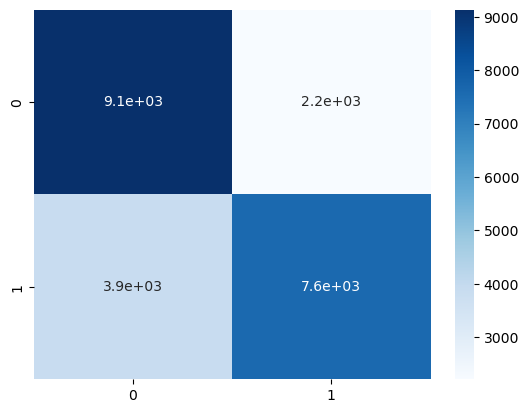

In [665]:
sns.heatmap(confusion, annot=True, cmap='Blues')

In [815]:
rand_train = ml_model.score(x_train, y_train)

In [816]:
rand_test = ml_model.score(x_test, y_test)

## Shap

In [666]:
import shap

In [667]:
explainer = shap.TreeExplainer(ml_model)

In [668]:
shap_values = explainer.shap_values(X)

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


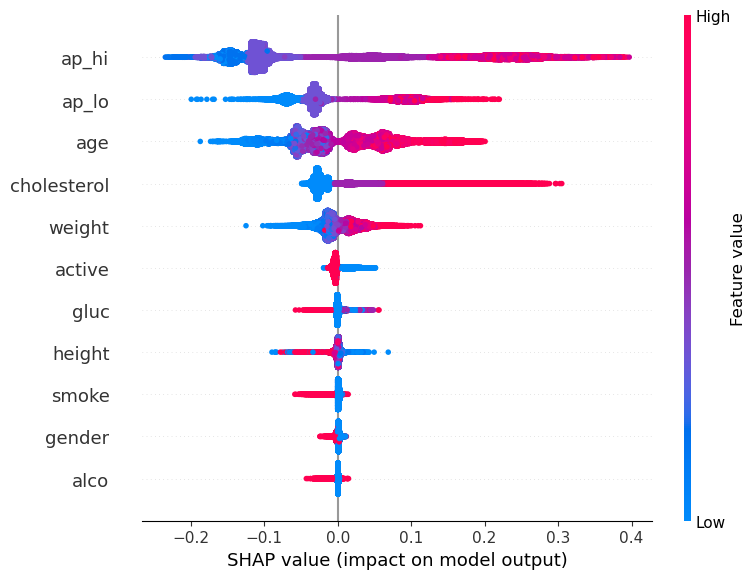

In [669]:
shap.summary_plot(shap_values[1], X)

In [670]:
n = 2

shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[0][n], x_train.iloc[n])

In [671]:
y_train.iloc[n]

0

## Teste com outros Modelos

In [721]:
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier

In [771]:
def report_ml(dataframe, algorithm, options = 2):
    Y = df_heart['cardio']
    X = df_heart.loc[:, df_heart.columns != 'cardio']
    
    x_train, x_test, y_train, y_test = train_test_split(X,Y, test_size=0.33, random_state=42)
    
    if options == 0:
        ml = algorithm(max_iter = 1000)
    elif options == 1:
        ml = algorithm(n_estimators = 1000)
    elif options == 2:
        ml = algorithm()
        
    ml.fit(x_train, y_train)
    score_train = ml.score(x_train, y_train)
    print(f'Precisão do Treino: {score_train * 100:.2f}%')
    score_test  = ml.score(x_test, y_test)
    print(f'Precisão do Teste: {score_test * 100:.2f}%')
    
    y_predicted = ml.predict(x_test)
    print('--- RELATÓRIO DE CLASSIFICAÇÃO ---')
    print(classification_report(y_test, y_predicted))
    print('--- MATRIZ DE CONFUSÃO ---')
    confusion = confusion_matrix(y_test, y_predicted)
    sns.heatmap(confusion, annot = True, cmap = 'Blues')
    
    return score_train, score_test

Precisão do Treino: 70.47%
Precisão do Teste: 69.80%
--- RELATÓRIO DE CLASSIFICAÇÃO ---
              precision    recall  f1-score   support

           0       0.68      0.75      0.71     11347
           1       0.72      0.65      0.68     11474

    accuracy                           0.70     22821
   macro avg       0.70      0.70      0.70     22821
weighted avg       0.70      0.70      0.70     22821

--- MATRIZ DE CONFUSÃO ---


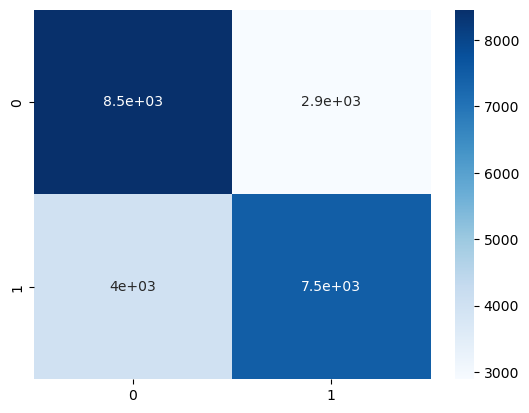

In [772]:
log_train, log_test = report_ml(df_heart, LogisticRegression, options = 0)

Precisão do Treino: 99.99%
Precisão do Teste: 63.65%
--- RELATÓRIO DE CLASSIFICAÇÃO ---
              precision    recall  f1-score   support

           0       0.63      0.64      0.64     11347
           1       0.64      0.64      0.64     11474

    accuracy                           0.64     22821
   macro avg       0.64      0.64      0.64     22821
weighted avg       0.64      0.64      0.64     22821

--- MATRIZ DE CONFUSÃO ---


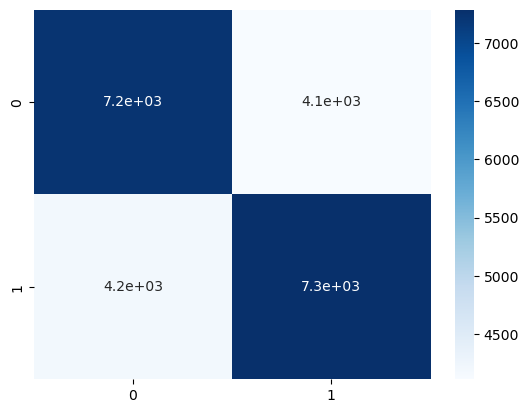

In [773]:
tree_train, tree_test = report_ml(df_heart, DecisionTreeClassifier)

Precisão do Treino: 73.03%
Precisão do Teste: 72.88%
--- RELATÓRIO DE CLASSIFICAÇÃO ---
              precision    recall  f1-score   support

           0       0.70      0.81      0.75     11347
           1       0.78      0.65      0.71     11474

    accuracy                           0.73     22821
   macro avg       0.74      0.73      0.73     22821
weighted avg       0.74      0.73      0.73     22821

--- MATRIZ DE CONFUSÃO ---


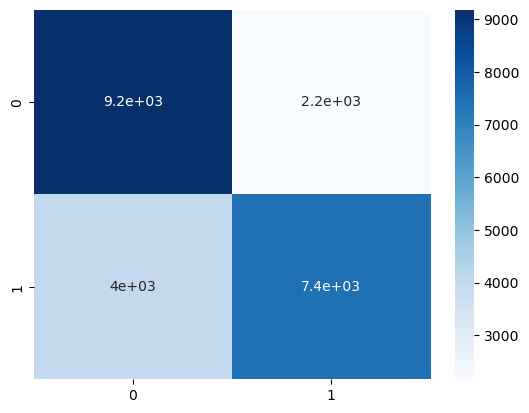

In [774]:
ada_train, ada_test = report_ml(df_heart, AdaBoostClassifier)

Precisão do Treino: 77.97%
Precisão do Teste: 67.93%
--- RELATÓRIO DE CLASSIFICAÇÃO ---
              precision    recall  f1-score   support

           0       0.67      0.71      0.69     11347
           1       0.69      0.65      0.67     11474

    accuracy                           0.68     22821
   macro avg       0.68      0.68      0.68     22821
weighted avg       0.68      0.68      0.68     22821

--- MATRIZ DE CONFUSÃO ---


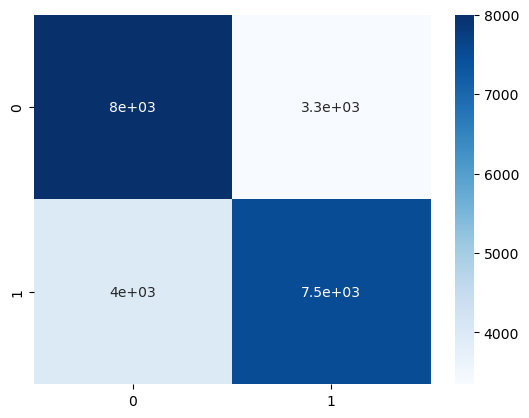

In [775]:
kn_train, kn_test = report_ml(df_heart, KNeighborsClassifier)

,Models,Precisão do Treino,Precisão do Teste
0,Logistic Regression,70.47,69.80
1,Decision Tree,99.99,63.65
2,KNeighbors,77.97,67.93
3,Ada Boost,73.03,72.88


### Standard Scaler

In [803]:
def report_ml_scaler(dataframe, algorithm, options = 2):
    Y = df_heart['cardio']
    X = df_heart.loc[:, df_heart.columns != 'cardio']
                  
    x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
    
    scaler = StandardScaler()
    cols_scaler =  ['age', 'ap_hi', 'ap_lo', 'weight', 'gluc', 'cholesterol']
    x_train[cols_scaler] = scaler.fit_transform(x_train[cols_scaler])
    x_test[cols_scaler] = scaler.transform(x_test[cols_scaler])
    
    if options == 0:
        ml = algorithm(max_iter = 1000)
    elif options == 1:
        ml = algorithm(n_estimators = 1000)
    elif options == 2:
        ml = algorithm()
        
    ml.fit(x_train, y_train)
    score_train = ml.score(x_train, y_train)
    print(f'Precisão do Treino: {score_train * 100:.2f}%')
    score_test  = ml.score(x_test, y_test)
    print(f'Precisão do Teste: {score_test * 100:.2f}%')
    
    y_predicted = ml.predict(x_test)
    print('--- CLASSIFICATION REPORT ---')
    print(classification_report(y_test, y_predicted))
    print('--- CONFUSION MATRIX ---')
    confusion = confusion_matrix(y_test, y_predicted)
    sns.heatmap(confusion, annot = True, cmap = 'Blues')
    
    return score_train, score_test

Precisão do Treino: 72.67%
Precisão do Teste: 72.25%
--- CLASSIFICATION REPORT ---
              precision    recall  f1-score   support

           0       0.70      0.78      0.74      6858
           1       0.75      0.67      0.71      6973

    accuracy                           0.72     13831
   macro avg       0.73      0.72      0.72     13831
weighted avg       0.73      0.72      0.72     13831

--- CONFUSION MATRIX ---


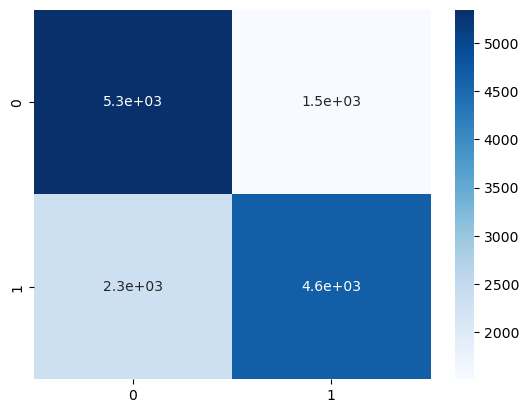

In [804]:
log_train_scaler, log_test_scaler = report_ml_scaler(df_heart, LogisticRegression, options = 0)

Precisão do Treino: 99.98%
Precisão do Teste: 62.99%
--- CLASSIFICATION REPORT ---
              precision    recall  f1-score   support

           0       0.62      0.64      0.63      6858
           1       0.64      0.62      0.63      6973

    accuracy                           0.63     13831
   macro avg       0.63      0.63      0.63     13831
weighted avg       0.63      0.63      0.63     13831

--- CONFUSION MATRIX ---


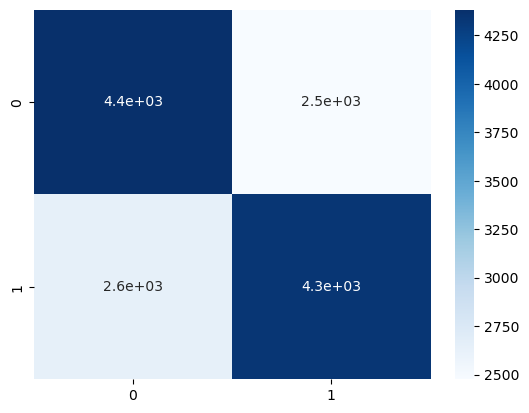

In [805]:
tree_train_scaler, tree_test_scaler = report_ml_scaler(df_heart, DecisionTreeClassifier)

Precisão do Treino: 73.18%
Precisão do Teste: 72.55%
--- CLASSIFICATION REPORT ---
              precision    recall  f1-score   support

           0       0.69      0.80      0.74      6858
           1       0.77      0.65      0.70      6973

    accuracy                           0.73     13831
   macro avg       0.73      0.73      0.72     13831
weighted avg       0.73      0.73      0.72     13831

--- CONFUSION MATRIX ---


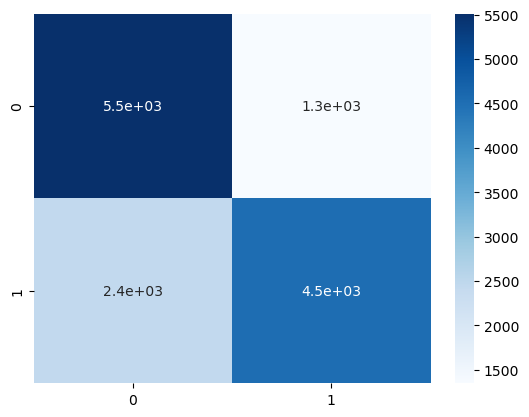

In [806]:
ada_train_scaler, ada_test_scaler = report_ml_scaler(df_heart, AdaBoostClassifier)

Precisão do Treino: 78.51%
Precisão do Teste: 68.82%
--- CLASSIFICATION REPORT ---
              precision    recall  f1-score   support

           0       0.68      0.71      0.69      6858
           1       0.70      0.67      0.68      6973

    accuracy                           0.69     13831
   macro avg       0.69      0.69      0.69     13831
weighted avg       0.69      0.69      0.69     13831

--- CONFUSION MATRIX ---


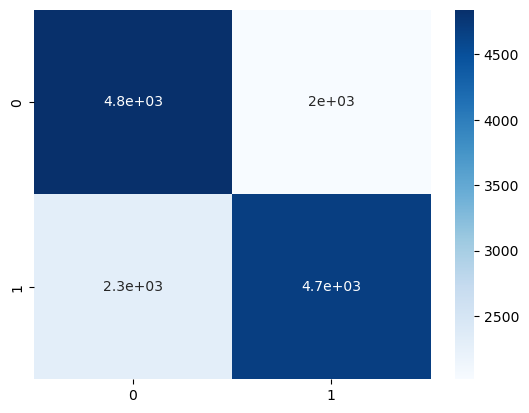

In [807]:
kn_train_scaler, kn_test_scaler = report_ml_scaler(df_heart, KNeighborsClassifier)

Precisão do Treino: 99.98%
Precisão do Teste: 70.78%
--- CLASSIFICATION REPORT ---
              precision    recall  f1-score   support

           0       0.70      0.73      0.71      6858
           1       0.72      0.69      0.70      6973

    accuracy                           0.71     13831
   macro avg       0.71      0.71      0.71     13831
weighted avg       0.71      0.71      0.71     13831

--- CONFUSION MATRIX ---


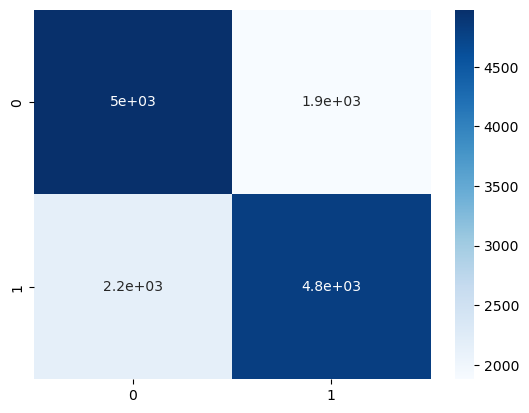

In [808]:
rand_train_scaler, rand_test_scaler = report_ml_scaler(df_heart, RandomForestClassifier)

In [818]:
data = { 'Models' : ['Logistic Regression', 'Decision Tree', 'KNeighbors', 'Random Forest Classifier','Ada Boost'],
       'Precisão do Treino': [round(log_train * 100, 2), round(tree_train * 100, 2), round(kn_train * 100, 2), round(rand_train * 100, 2),round(ada_train * 100, 2),],
       'Precisão do Teste': [round(log_test * 100, 2), round(tree_test * 100, 2), round(kn_test * 100, 2), round(rand_test * 100, 2),round(ada_test * 100, 2)],
       }
dataframe = pd.DataFrame(data)
dataframe.sort_values(by='Precisão do Teste', ascending=True, inplace=False)
dataframe

,Models,Precisão do Treino,Precisão do Teste
0,Logistic Regression,70.47,69.80
1,Decision Tree,99.99,63.65
2,KNeighbors,77.97,67.93
3,Random Forest Classifier,74.50,73.31
4,Ada Boost,73.03,72.88


In [817]:
data_scaler = { 'Models' : ['Logistic Regression', 'Decision Tree', 'KNeighbors', 'Random Forest Classifier', 'Ada Boost'],
       'Precisão do Treino': [round(log_train_scaler * 100, 2), round(tree_train_scaler * 100, 2), round(kn_train_scaler * 100, 2), round(rand_train_scaler * 100, 2),round(ada_train_scaler * 100, 2),],
       'Precisão do Teste': [round(log_test_scaler * 100, 2), round(tree_test_scaler * 100, 2), round(kn_test_scaler * 100, 2),round(rand_test_scaler * 100, 2),round(ada_test_scaler * 100, 2)],
       }
dataframe_scaler = pd.DataFrame(data_scaler)
dataframe_scaler.sort_values(by='Precisão do Teste', ascending=True, inplace=False)
dataframe_scaler

,Models,Precisão do Treino,Precisão do Teste
0,Logistic Regression,72.67,72.25
1,Decision Tree,99.98,62.99
2,KNeighbors,78.51,68.82
3,Random Forest Classifier,99.98,70.78
4,Ada Boost,73.18,72.55


### Treino

### Teste

In [856]:
fig5 = make_subplots(rows=1, cols=1)
fig5.add_trace(go.Bar(y=dataframe['Precisão do Teste'], x=[dataframe['Models'][0],dataframe['Models'][1],dataframe['Models'][2],dataframe['Models'][3],dataframe['Models'][4]], name='Sem Standard Scaler'), row=1, col=1)
fig5.add_trace(go.Bar(y=dataframe_scaler['Precisão do Teste'], x=[dataframe_scaler['Models'][0],dataframe_scaler['Models'][1],dataframe_scaler['Models'][2],dataframe_scaler['Models'][3],dataframe_scaler['Models'][4]], name='Com Standard Scaler'), row=1, col=1)
fig5.update_layout(height=700)
fig5.show()